# Analysis of Stock Market data using Pandas and Python Libraries

In [1]:
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go

from statsmodels.tsa.stattools import adfuller
from tqdm import tqdm

from datetime import datetime
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

import os

# Exploratory data analysis

In [2]:
data=pd.read_csv('C:\\Users\\ANIRUDDHA\\Documents\\pandas\\stock_data.csv')
print('shape dims{}'.format(data.shape))
data.head()

shape dims(279452, 12)


,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits,Brand_Name,Ticker,Industry_Tag,Country
0,2023-09-14 00:00:00-04:00,5.220000,5.259000,5.080000,5.150000,8813000.0,0.0,0.0,peloton,PTON,fitness,usa
1,2023-09-14 00:00:00-04:00,410.399994,411.390015,400.000000,400.489990,10709000.0,0.0,0.0,netflix,NFLX,entertainment,usa
2,2023-09-14 00:00:00-04:00,564.809998,566.700012,560.250000,564.770020,1257300.0,0.0,0.0,costco,COST,retail,usa
3,2023-09-14 00:00:00-04:00,145.080002,145.860001,142.949997,144.720001,64033600.0,0.0,0.0,amazon,AMZN,e-commerce,usa
4,2023-09-14 00:00:00-04:00,174.000000,176.100006,173.580002,175.740005,60895800.0,0.0,0.0,apple,AAPL,technology,usa


# print information

In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 279452 entries, 0 to 279451
Data columns (total 12 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   Date          279452 non-null  object 
 1   Open          279452 non-null  float64
 2   High          279452 non-null  float64
 3   Low           279452 non-null  float64
 4   Close         279452 non-null  float64
 5   Volume        279452 non-null  float64
 6   Dividends     279452 non-null  float64
 7   Stock Splits  279452 non-null  float64
 8   Brand_Name    279452 non-null  object 
 9   Ticker        279452 non-null  object 
 10  Industry_Tag  279452 non-null  object 
 11  Country       279452 non-null  object 
dtypes: float64(7), object(5)
memory usage: 25.6+ MB


# Print the format of Date, which is still Object

In [4]:
data['Date'][0]

'2023-09-14 00:00:00-04:00'

# Before changing the type of Date from string to datetime, check for the granularity of the dataset

In [5]:
data['date_for_check']=data['Date'].str[:10]
data['time_for_check']=data['Date'].str[11:]
data.groupby(by=['date_for_check','Ticker']).count().query('time_for_check > 1')[['time_for_check']]

time_for_check
date_for_check Ticker                
2023-09-08     AAPL                 2
               ABNB                 2
               ADBE                 2
               ADDYY                2
               AEO                  2
...                               ...
2023-09-13     TSLA                 2
               UBER                 2
               V                    2
               ZI                   2
               ZM                   2

[102 rows x 1 columns]

# See the double value for the 2023-09-08. Clean the dataset

In [6]:
ticker_to_check=data.groupby(by=['date_for_check','Ticker']).count().query('time_for_check > 1')[['time_for_check']].index.get_level_values(1).tolist()
data.query('Ticker in @ticker_to_check and date_for_check=="2023-09-08"').set_index(['Ticker','time_for_check'])[['Open','High','Low','Close','Volume','Dividends']].sort_values('Ticker')

Open        High         Low       Close  \
Ticker time_for_check                                                   
AAPL   00:00:00-04:00  178.350006  180.238998  177.789993  178.179993   
       00:00:00-04:00  178.350006  180.240005  177.789993  178.179993   
ABNB   00:00:00-04:00  143.940002  146.842499  143.354996  145.820007   
       00:00:00-04:00  143.940002  146.850006  143.179993  145.820007   
ADBE   00:00:00-04:00  568.900024  570.239929  558.030029  560.359985   
...                           ...         ...         ...         ...   
V      00:00:00-04:00  247.789993  248.139999  246.440002  247.289993   
ZI     00:00:00-04:00   17.799999   17.865000   17.430000   17.590000   
       00:00:00-04:00   17.799999   17.865000   17.430000   17.590000   
ZM     00:00:00-04:00   73.680000   73.800003   71.639999   72.059998   
       00:00:00-04:00   73.680000   73.800003   71.639999   72.059998   

                           Volume  Dividends  
Ticker time_for_check                         
AAPL   00:00:00-04:00  65602066.0        0.0  
       00:00:00-04:00  65551300.0        0.0  
ABNB   00:00:00-04:00   9329068.0        0.0  
       00:00:00-04:00   9326600.0        0.0  
ADBE   00:00:00-04:00   2265288.0        0.0  
...                           ...        ...  
V      00:00:00-04:00   3309100.0        0.0  
ZI     00:00:00-04:00   5182828.0        0.0  
       00:00:00-04:00   5182700.0        0.0  
ZM     00:00:00-04:00   3885348.0        0.0  
       00:00:00-04:00   3882800.0        0.0  

[118 rows x 6 columns]

# see the double value for 2023-09-13 and clean the dataset

In [7]:
ticker_to_check=data.groupby(by=['date_for_check','Ticker']).count().query('time_for_check > 1')[['time_for_check']].index.get_level_values(1).tolist()
data.query('Ticker in @ticker_to_check and date_for_check=="2023-09-08"').set_index(['Ticker','time_for_check'])[['Open','High','Low','Close','Volume','Dividends']].sort_values('Ticker')

Open        High         Low       Close  \
Ticker time_for_check                                                   
AAPL   00:00:00-04:00  178.350006  180.238998  177.789993  178.179993   
       00:00:00-04:00  178.350006  180.240005  177.789993  178.179993   
ABNB   00:00:00-04:00  143.940002  146.842499  143.354996  145.820007   
       00:00:00-04:00  143.940002  146.850006  143.179993  145.820007   
ADBE   00:00:00-04:00  568.900024  570.239929  558.030029  560.359985   
...                           ...         ...         ...         ...   
V      00:00:00-04:00  247.789993  248.139999  246.440002  247.289993   
ZI     00:00:00-04:00   17.799999   17.865000   17.430000   17.590000   
       00:00:00-04:00   17.799999   17.865000   17.430000   17.590000   
ZM     00:00:00-04:00   73.680000   73.800003   71.639999   72.059998   
       00:00:00-04:00   73.680000   73.800003   71.639999   72.059998   

                           Volume  Dividends  
Ticker time_for_check                         
AAPL   00:00:00-04:00  65602066.0        0.0  
       00:00:00-04:00  65551300.0        0.0  
ABNB   00:00:00-04:00   9329068.0        0.0  
       00:00:00-04:00   9326600.0        0.0  
ADBE   00:00:00-04:00   2265288.0        0.0  
...                           ...        ...  
V      00:00:00-04:00   3309100.0        0.0  
ZI     00:00:00-04:00   5182828.0        0.0  
       00:00:00-04:00   5182700.0        0.0  
ZM     00:00:00-04:00   3885348.0        0.0  
       00:00:00-04:00   3882800.0        0.0  

[118 rows x 6 columns]

# Drop double values for date and create column date in datetime format

In [8]:
data=data.groupby(by=['Date','Ticker']).first().reset_index()
data['Date']=pd.to_datetime(data['Date'].str[:10])
data.drop(columns=['date_for_check','time_for_check'],inplace=True)
data.rename(columns={'Stock Splits':'Stock_Splits'},inplace=True)

# Missing values per column

In [9]:
data.isna().sum()

Date            0
Ticker          0
Open            0
High            0
Low             0
Close           0
Volume          0
Dividends       0
Stock_Splits    0
Brand_Name      0
Industry_Tag    0
Country         0
dtype: int64

In [10]:
print('Number of companies: {}'.format(data.Ticker.nunique()))
Companies=data.Ticker.unique()
print('Number of sectors: {}'.format(data.Industry_Tag.nunique()))
Sectors=data.Industry_Tag.unique()

Number of companies: 61
Number of sectors: 23


# Number of companies per sector

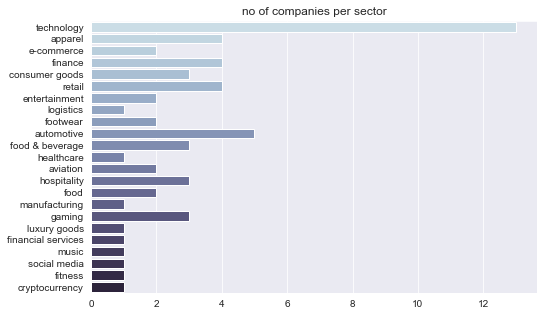

In [11]:
sns.set_style('darkgrid')
order_of_sector=data[['Ticker','Industry_Tag']].drop_duplicates()['Industry_Tag'].value_counts().index
fig=plt.figure(figsize=(8,5))
sns.countplot(
    data=data[['Ticker','Industry_Tag']].drop_duplicates(),
    y='Industry_Tag',
    palette='ch:s=.25,rot=-.25'
)
plt.title('no of companies per sector')
plt.ylabel('')
plt.xlabel('')
plt.show()

In [12]:
data[['Ticker','Country']].drop_duplicates().groupby(by=['Country']).count().index

Index(['canada', 'france', 'germany', 'japan', 'netherlands', 'switzerland',
       'usa'],
      dtype='object', name='Country')

# Percentage of companies per country

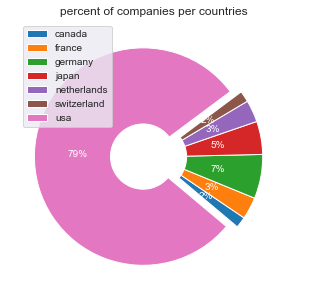

In [13]:
order_for_country=data[['Ticker','Country']].drop_duplicates()['Country'].value_counts().index
fig=plt.figure(figsize=(8,5))
plt.pie(
    x=data[['Ticker','Country']].drop_duplicates().groupby(by=['Country']).count().Ticker.values,
    labels=data[['Ticker','Country']].drop_duplicates().groupby(by=['Country']).count().index,
    explode=np.array([0,0,0,0,0,0,0.1]),
    autopct="%1.0f%%",
    wedgeprops=dict(width=0.7),
    startangle=-40,
    textprops={'color':"w"}
)
plt.title("percent of companies per countries")
plt.legend()
plt.show()

# Number of companies per country and sector

In [14]:
data.groupby(by = ['Country', 'Industry_Tag'])[['Ticker']].nunique().sort_values(
    by = ['Ticker'], ascending = False
).reset_index().rename(
    columns = {'Ticker' : 'Number of companies', 'Industry_Tag' : 'Sector'}
)

,Country,Sector,Number of companies
0,usa,technology,11
1,usa,retail,4
2,usa,finance,4
3,usa,hospitality,3
4,usa,food & beverage,3
5,usa,apparel,2
6,usa,footwear,2
7,usa,food,2
8,usa,consumer goods,2
9,usa,aviation,2


# Number of companies through time

In [15]:
fig=px.line(
    data_frame=data.groupby('Date')[['Ticker']].count().reset_index().rename(columns={'Ticker':'No_of_companies'}),
    x='Date', y='No_of_companies',
)
fig.update_layout(
    title='no of companies through time',
    xaxis_title="",
    yaxis_title=""
)
fig.show()

In [16]:
company_with_divident=list(data.query('Dividends>0')[['Ticker']].drop_duplicates().Ticker.values)
data.query('Dividends>0')[['Ticker','Brand_Name','Industry_Tag','Dividends']].groupby(by=['Ticker','Brand_Name','Industry_Tag']).count().sort_values('Dividends',ascending=False).reset_index()

,Ticker,Brand_Name,Industry_Tag,Dividends
0,HD,the home depot,retail,96
1,PG,procter & gamble,consumer goods,96
2,NKE,nike,apparel,95
3,MMM,3m,manufacturing,95
4,AXP,american express,finance,95
5,TGT,target,retail,95
6,CL,colgate palmolive,consumer goods,95
7,KO,the coca-cola company,food & beverage,95
8,JPM,jpmorgan chase & co,finance,95
9,JNJ,johnson & johnson,healthcare,95


# Companies with stock splits

In [17]:
company_with_split=list(data.query('Stock_Splits>0')[['Ticker']].drop_duplicates().Ticker.values)
data.query('Stock_Splits>0')[['Ticker','Brand_Name','Stock_Splits']].groupby(by=['Ticker','Brand_Name']).count().sort_values('Stock_Splits',ascending=False).reset_index()

,Ticker,Brand_Name,Stock_Splits
0,MAR,marriott,5
1,NVDA,nvidia,5
2,AAPL,apple,4
3,SBUX,starbucks,3
4,NKE,nike,3
5,LOGI,logitech,3
6,AEO,american eagle outfitters,3
7,AXP,american express,2
8,TSLA,tesla,2
9,GOOGL,google,2


# A function that plot time series of a company and its stock splits

In [18]:
def plot_timeseries(data, ticker, timeseries):
    df = data[['Date', 'Ticker', timeseries]].set_index(['Date', 'Ticker']).unstack(1)
    df = df.droplevel(level = 0, axis = 1)
    df = df.reset_index()

    fig = px.line(df, x = 'Date', y = ticker)
    for date in data.query('Ticker == @ticker and Stock_Splits > 0')[['Date']].Date.values: 
        fig.add_vline(
            x = date,
            line_width = 1, line_color = "red"
        )

    fig.update_layout(
        title = ticker+' - '+timeseries+' time series ($)',
        xaxis_title="",
        yaxis_title="",
    )

    fig.show()

In [19]:
 plot_timeseries(data,'ADBE','Open')

# Average trading volume per sector

In [20]:
fig=px.line(
    data[['Date','Ticker','Open','Industry_Tag']]\
    .groupby(['Date','Industry_Tag'])[['Open']].mean().reset_index(),
    x='Date',y='Open',color='Industry_Tag'
)
fig.update_layout(
    title='Average open time series ($) per sector',
    xaxis_title='',
    yaxis_title='',
)
fig.show()

# Open, High, Low and Close are strongly positively correlated.
I try to extrapolate the information by expressing the last time series as the differenze wrt the first one.
Then, I add Open_t (ie Order transformed, that is Open scaled into min-max range),
in order to compare different order of magnitude time series

In [21]:
timeseries=['Open','High','Low','Close','Volume']
data_t=data.copy()
for col in timeseries[1:4]:
    data_t[col]=data_t[col]-data_t['Open']
    data_t['Open_t']=data_t.groupby(by='Ticker')['Open'].transform(lambda x:(x-np.min(x))/(np.max(x)-np.min(x)))
    timeseries.append('Open_t')
    data_t.head()

In [22]:
data_t.head()

,Date,Ticker,Open,High,Low,Close,Volume,Dividends,Stock_Splits,Brand_Name,Industry_Tag,Country,Open_t
0,2000-01-03,AAPL,0.794800,0.057786,-0.024157,0.053523,535796800.0,0.0,0.0,apple,technology,usa,0.003054
1,2000-01-03,ADBE,16.693566,0.062058,-0.744694,-0.418891,7384400.0,0.0,0.0,adobe,technology,usa,0.011917
2,2000-01-03,AEO,5.731675,0.062301,-0.303716,-0.249203,5825700.0,0.0,0.0,american eagle outfitters,apparel,usa,0.123308
3,2000-01-03,AMD,14.968750,0.625000,-0.281250,0.531250,7843200.0,0.0,0.0,amd,technology,usa,0.082573
4,2000-01-03,AMZN,4.075000,0.403125,-0.122656,0.393750,322352000.0,0.0,0.0,amazon,e-commerce,usa,0.020222


# Trading volume per sector

In [23]:
sector='technology'
fig=px.line(
    data.query('Industry_Tag==@sector')[['Date','Ticker','Volume']],
    x='Date',y='Volume',color='Ticker'
)
fig.update_layout(
    title='Tranding volume ($) of sector '+sector,
    xaxis_title='',
    yaxis_title='',
)
fig.show()

In [24]:
plot_timeseries(data_t,'AAPL','High')
plot_timeseries(data_t,'AAPL','Low')

# Correlations of transformed Open time series of different companies within the same sectors

In [25]:
def corr_sector(sector):
    company = data_t.query('Industry_Tag == @sector')['Ticker'].unique()
    df = data_t.query('Ticker == @company[0]')[['Date', 'Open_t']].rename(columns = {'Open_t' : company[0]})
    for company in company[1:]:
        df = pd.merge(
            df,
            data_t.query('Ticker == @company')[['Date', 'Open_t']].rename(columns = {'Open_t' : company}),
            on = ['Date']
        )
    df = df.set_index('Date')

    plt.figure(figsize=(7, 5))
    heatmap = sns.heatmap(df.corr(), vmin = -1, vmax = 1, annot = True, cmap = 'BrBG', fmt='1.1f')
    heatmap.set_title(sector, fontdict = {'fontsize':14}, pad = 12)
    plt.show()

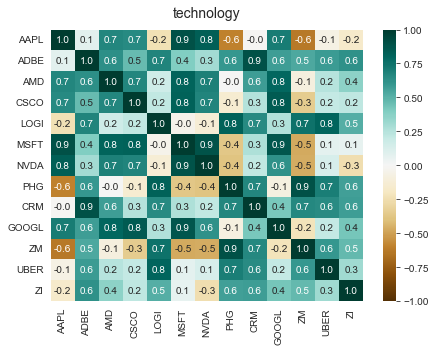

In [26]:
corr_sector('technology')